In [1]:
import pandas as pd
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import OrdinalEncoder,OneHotEncoder, MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.compose import make_column_transformer
from sklearn.model_selection import train_test_split
from sklearn.metrics import  confusion_matrix
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import make_pipeline as make_imb_pipeline
from imblearn.metrics import classification_report_imbalanced
from sklearn.model_selection import cross_validate,cross_val_score
from sklearn import metrics

import catboost as cb
import optuna

In [2]:
dir2 = Path.cwd().joinpath("data","raw_data","data_phase-1","phase-1","prob-2","raw_train.parquet")
df2 = pd.read_parquet(dir2)

In [3]:
df2

,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,...,feature12,feature13,feature14,feature15,feature16,feature17,feature18,feature19,feature20,label
0,V1,4.781942,V2,V8,1337.025331,V4,V4,2.0,V2,V0,...,V2,35.689494,none,V1,1.0,V2,1.0,none,yes,0
1,V3,22.764682,V4,V2,1664.415301,V0,V4,4.0,V1,V0,...,V0,23.265980,none,V1,2.0,V2,1.0,none,yes,0
2,V3,7.462099,V2,V3,750.653224,V3,V2,4.0,V2,V0,...,V2,34.060872,stores,V0,1.0,V2,1.0,yes,yes,0
3,V3,23.718364,V4,V7,4829.002078,V4,V2,4.0,V1,V0,...,V3,62.477448,none,V1,2.0,V1,1.0,none,yes,0
4,V3,13.768903,V3,V3,3559.956292,V3,V4,1.0,V1,V0,...,V2,41.999120,bank,V1,1.0,V2,1.0,yes,yes,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59995,V3,5.834186,V2,V0,1549.229155,V0,V4,3.0,V2,V2,...,V0,52.368811,none,V1,1.0,V2,2.0,none,yes,0
59996,V2,10.379676,V2,V2,2417.228753,V0,V0,2.0,V1,V0,...,V0,70.966537,none,V1,1.0,V0,1.0,none,yes,0
59997,V3,11.601652,V2,V0,1488.169842,V0,V2,2.0,V2,V0,...,V1,32.796094,none,V1,1.0,V1,1.0,none,yes,0
59998,V1,13.837508,V4,V3,11925.211726,V0,V1,2.0,V2,V0,...,V3,33.884187,none,V1,2.0,V2,1.0,none,yes,0


In [4]:
import hiplot as hip
data = df2.to_dict(orient='records')

hip.Experiment.from_iterable(data).display()

<IPython.core.display.Javascript object>

<Axes: xlabel='feature1', ylabel='feature2'>

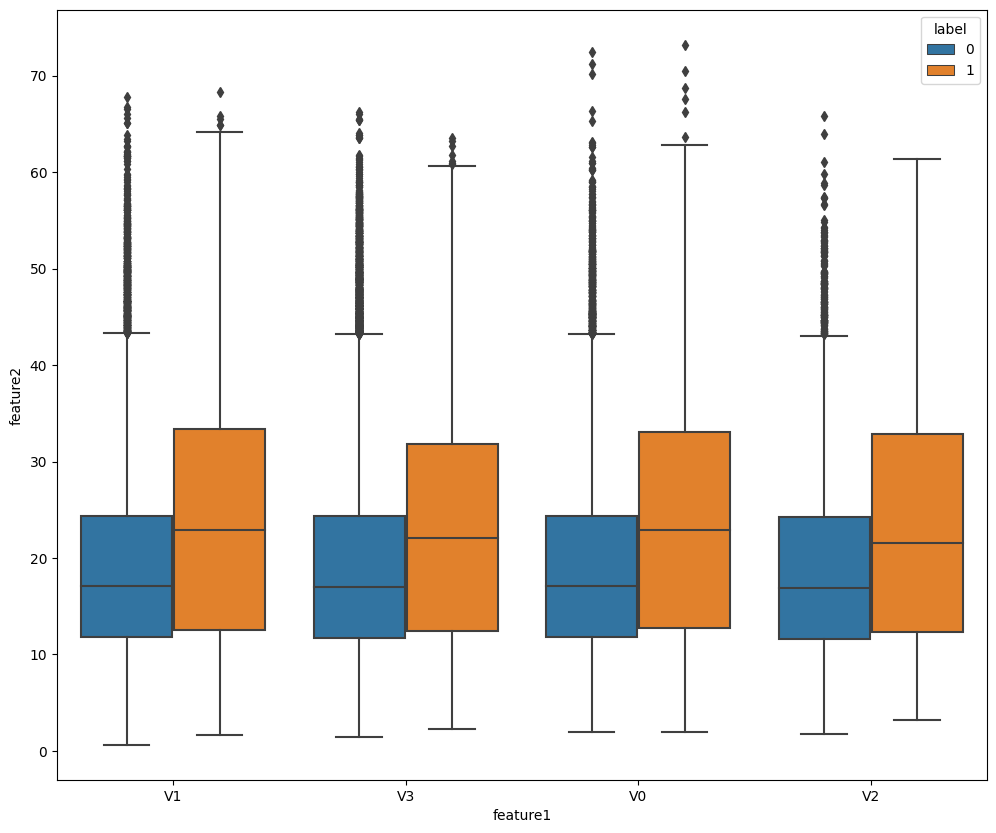

In [40]:
plt.figure(figsize=(12,10))
sns.boxplot(x = 'feature1', y = 'feature5', hue = 'label', data = df2)

In [16]:
X = df2.drop(["label"], axis=1)
y = df2["label"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 2023)

numeric_feats = ["feature2",
                 "feature5",
                 "feature13",
                 "feature18"]
categorical_feats= ["feature1",
                    "feature3",
                    "feature4",
                    "feature6",
                    "feature7",
                    "feature8",
                    "feature9",
                    "feature10",
                    "feature11",
                    "feature12",
                    "feature14",
                    "feature15",
                    "feature16",
                    "feature17",
                    "feature19",
                    "feature20"]

numeric_transformer = make_pipeline(
    SimpleImputer(strategy = "median"), MinMaxScaler()
    )

cat_ordinal_transformer = make_pipeline(
    SimpleImputer(strategy = 'most_frequent'),            
    OrdinalEncoder(handle_unknown = "use_encoded_value", unknown_value = -1)
)

cat_onehot_transformer = make_pipeline(
    SimpleImputer(strategy = 'most_frequent'),            
    OneHotEncoder(handle_unknown = 'ignore')
)


In [17]:

feature1_baseline = make_column_transformer(
    (numeric_transformer, numeric_feats),
    (cat_ordinal_transformer, categorical_feats)
)

In [18]:
# Compute multiple scores during cross-validation
scoring = {
    "accuracy": "accuracy",
    "precision": "precision_macro",
    "recall": "recall_macro",
    "f1": "f1",
    "auc": "roc_auc",
    "auprc": "average_precision"
}

In [19]:
cbc = cb.CatBoostClassifier(random_state=2023,logging_level='Silent')

models = {
    "CatBoost Classifier" : cbc
}

In [21]:
# Get a list of available scorer names
scorer_names = metrics.get_scorer_names()

# Print the scorer names
print("Available scorer names:", scorer_names)

Available scorer names: ['accuracy', 'adjusted_mutual_info_score', 'adjusted_rand_score', 'average_precision', 'balanced_accuracy', 'completeness_score', 'explained_variance', 'f1', 'f1_macro', 'f1_micro', 'f1_samples', 'f1_weighted', 'fowlkes_mallows_score', 'homogeneity_score', 'jaccard', 'jaccard_macro', 'jaccard_micro', 'jaccard_samples', 'jaccard_weighted', 'matthews_corrcoef', 'max_error', 'mutual_info_score', 'neg_brier_score', 'neg_log_loss', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error', 'neg_mean_gamma_deviance', 'neg_mean_poisson_deviance', 'neg_mean_squared_error', 'neg_mean_squared_log_error', 'neg_median_absolute_error', 'neg_negative_likelihood_ratio', 'neg_root_mean_squared_error', 'normalized_mutual_info_score', 'positive_likelihood_ratio', 'precision', 'precision_macro', 'precision_micro', 'precision_samples', 'precision_weighted', 'r2', 'rand_score', 'recall', 'recall_macro', 'recall_micro', 'recall_samples', 'recall_weighted', 'roc_auc', 'roc_auc_o

In [22]:
# Fit the pipeline to the training data
def score_pipeline_model(X, y, preprocessor, models):
    dict_scores = {}
    smote = SMOTE(sampling_strategy=1, random_state=42, k_neighbors=5)
    for name, model in models.items():
        pipeline_baseline = make_imb_pipeline(
            preprocessor,
            smote,
            model
        )
        scores = cross_validate(pipeline_baseline, X, y, scoring = scoring, cv = 5, return_train_score = True)
        dict_scores[name] = scores
        # Evaluate model performance
        print('*' * 50)
        print(f"{name} Training score: Mean accuracy: {np.mean(scores['train_accuracy']):.3f} | \
            Mean precision: {np.mean(scores['train_precision']):.3f} | \
            Mean recall: {np.mean(scores['train_recall']):.3f} | \
            Mean f1: {np.mean(scores['train_f1']):.3f} | \
            Mean auc: {np.mean(scores['train_auc']):.3f} | \
            Mean auprc: {np.mean(scores['train_auprc']):.3f}")

        print(f"{name} Test score: Mean accuracy: {np.mean(scores['test_accuracy']):.3f} | \
            Mean precision: {np.mean(scores['test_accuracy']):.3f} | \
            Mean recall: {np.mean(scores['test_recall']):.3f} | \
            Mean f1: {np.mean(scores['test_f1']):.3f} | \
            Mean auc: {np.mean(scores['test_auc']):.3f} | \
            Mean auprc: {np.mean(scores['test_auprc']):.3f}")
    return dict_scores

In [23]:
cbc = cb.CatBoostClassifier(random_state=2023,logging_level='Silent')

models = {
    "CatBoost Classifier" : cbc
}

In [21]:
feature_baseline = score_pipeline_model(X_train, y_train, feature1_baseline, models)

**************************************************
CatBoost Classifier Training score: Mean accuracy: 0.862 |             Mean precision: 0.845 |             Mean recall: 0.820 |             Mean f1: 0.758 |             Mean auc: 0.921 |             Mean auprc: 0.853
CatBoost Classifier Test score: Mean accuracy: 0.822 |             Mean precision: 0.822 |             Mean recall: 0.773 |             Mean f1: 0.688 |             Mean auc: 0.878 |             Mean auprc: 0.770


In [25]:
def tune(objective):
    study = optuna.create_study(direction="maximize")
    study.optimize(objective, n_trials=50)

    params = study.best_params
    best_score = study.best_value
    print(f"Best score: {best_score} \nOptimized parameters: {params}")
    return params

In [26]:
def ctb_objective(trial):
  
    params = {
        "iterations": trial.suggest_int("iterations", 100, 2000),
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.1),
        "depth": trial.suggest_int("depth", 3, 10),
        "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 0.1, 10),
        "bagging_temperature": trial.suggest_float("bagging_temperature", 0, 1),
        "random_seed": 42,
        "loss_function": "Logloss",
        "eval_metric": "AUC",
        "verbose": False
    }

    # initialize the model with the hyperparameters
    cbc = cb.CatBoostClassifier(**params)
    smote = SMOTE(sampling_strategy=1, random_state=42, k_neighbors=5)
    model = make_imb_pipeline(
            feature1_baseline,
            smote,
            cbc
        ) 

    score = cross_val_score(
        model, X_train, y_train,  cv=5, scoring="average_precision"
    ).mean()
    return score 

ctb_params = tune(ctb_objective)

[I 2023-07-01 22:01:12,904] A new study created in memory with name: no-name-7d9b26af-b6f1-4149-ac01-aa0e1ea9b795
[I 2023-07-01 22:02:02,906] Trial 0 finished with value: 0.7587657753843402 and parameters: {'iterations': 1511, 'learning_rate': 0.01986369151192055, 'depth': 4, 'l2_leaf_reg': 0.42048969408350256, 'bagging_temperature': 0.231242477344202}. Best is trial 0 with value: 0.7587657753843402.
[I 2023-07-01 22:03:14,404] Trial 1 finished with value: 0.7611325735693237 and parameters: {'iterations': 1261, 'learning_rate': 0.08728002884321691, 'depth': 7, 'l2_leaf_reg': 7.743505587312378, 'bagging_temperature': 0.28093852154861976}. Best is trial 1 with value: 0.7611325735693237.
[I 2023-07-01 22:05:52,094] Trial 2 finished with value: 0.7572808632236094 and parameters: {'iterations': 1228, 'learning_rate': 0.06613425716708131, 'depth': 9, 'l2_leaf_reg': 8.618564378690458, 'bagging_temperature': 0.10760385357666669}. Best is trial 1 with value: 0.7611325735693237.
[I 2023-07-01 22

KeyboardInterrupt: 

In [10]:
# Define the CatBoost classifier
ctb_params = {'iterations': 753, 
              'learning_rate': 0.0404786810085891, 
              'depth': 8, 
              'l2_leaf_reg': 0.15444379705005332, 
              'bagging_temperature': 0.10998497242933192}
              
cb_model = cb.CatBoostClassifier(**ctb_params,logging_level='Silent')
smote = SMOTE(sampling_strategy=1, random_state=42, k_neighbors=5)
# Define the SMOTE pipeline
pipeline_baseline = make_imb_pipeline(
    feature1_baseline,
    smote,
    cb_model
)
# Fit the pipeline to the training data
pipeline_baseline.fit(X_train, y_train)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('pipeline-1',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('minmaxscaler',
                                                                   MinMaxScaler())]),
                                                  ['feature2', 'feature5',
                                                   'feature13', 'feature18']),
                                                 ('pipeline-2',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('ordinalencoder',
                                                                   OrdinalEnco..._encoded_value',
                                                                                  unknown_value=-1))]),
                                                  ['feature1', 'feature3',
                                                   'feature4', 'feature6',
                                                   'feature7', 'feature8',
                                                   'feature9', 'feature10',
                                                   'feature11', 'feature12',
                                                   'feature14', 'feature15',
                                                   'feature16', 'feature17',
                                                   'feature19'])])),
                ('smote', SMOTE(random_state=42, sampling_strategy=1)),
                ('catboostclassifier',
                 <catboost.core.CatBoostClassifier object at 0x7f39728b5fc0>)])

                   pre       rec       spe        f1       geo       iba       sup

    class 0       0.85      0.90      0.63      0.87      0.75      0.58      8362
    class 1       0.73      0.63      0.90      0.68      0.75      0.55      3638

avg / total       0.81      0.82      0.71      0.81      0.75      0.57     12000

[[7504  858]
 [1345 2293]]


<Axes: >

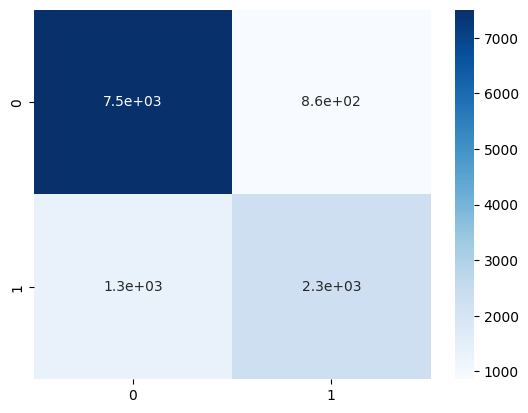

In [11]:
import seaborn as sns
y_pred = pipeline_baseline.predict_proba(X_test)[:,1]
y_pred_binary = np.where(y_pred >= 0.5, 1, 0)
target_names = ['class 0', 'class 1']
print(classification_report_imbalanced(y_test, y_pred_binary,  target_names=target_names))
conf_mat = confusion_matrix(y_test, y_pred_binary)
print(conf_mat)

sns.heatmap(conf_mat, annot=True, cmap='Blues')

In [13]:
false_negatives = X_test.loc[(y_test == 1) & (y_pred_binary == 0), :]
false_positives = X_test.loc[(y_test == 0) & (y_pred_binary == 1), :]

In [14]:
import hiplot as hip
df_false_negatives = false_negatives.to_dict(orient='records')

hip.Experiment.from_iterable(df_false_negatives).display()

<IPython.core.display.Javascript object>